In [1]:
import json 
import numpy as np
from Functions import Import_New, Image_Proccess, alignment_cent_calc, relative_alignment
from matplotlib import pyplot as plt

In [2]:
image_DC1 = Import_New("DC1_images")
image_DC2 = Import_New("DC2_images")

In [3]:
#print(image_DC1)

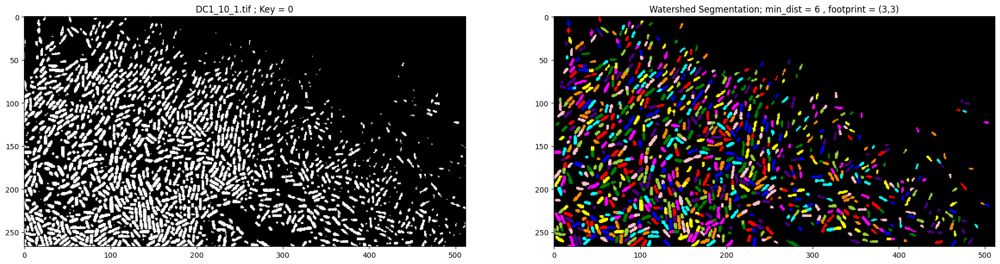

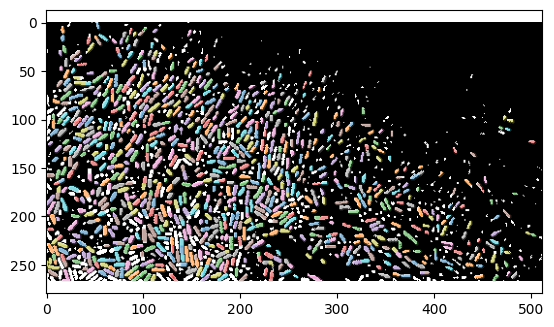

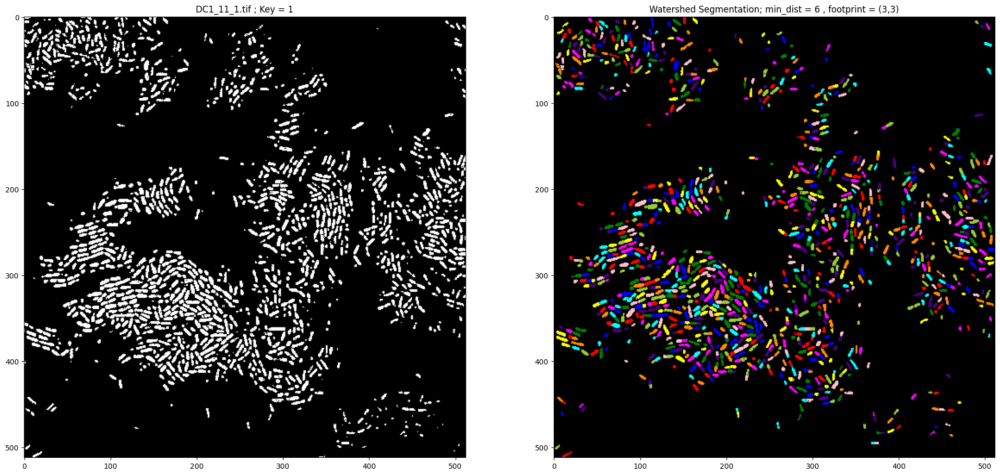

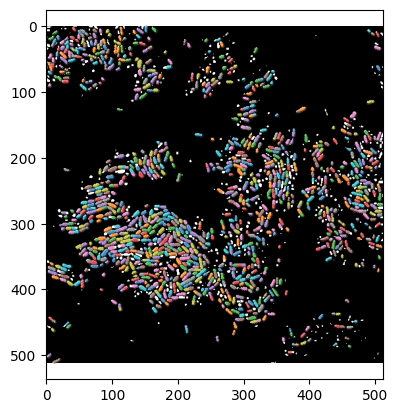

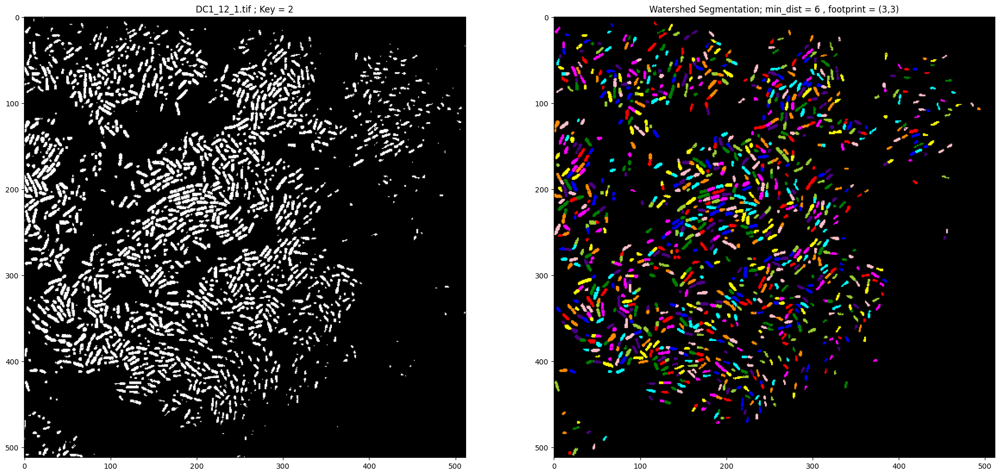

...

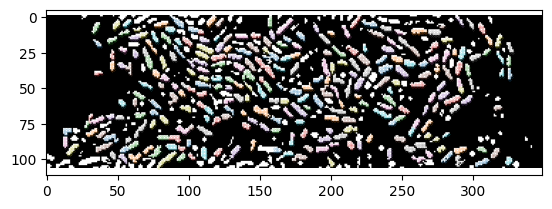

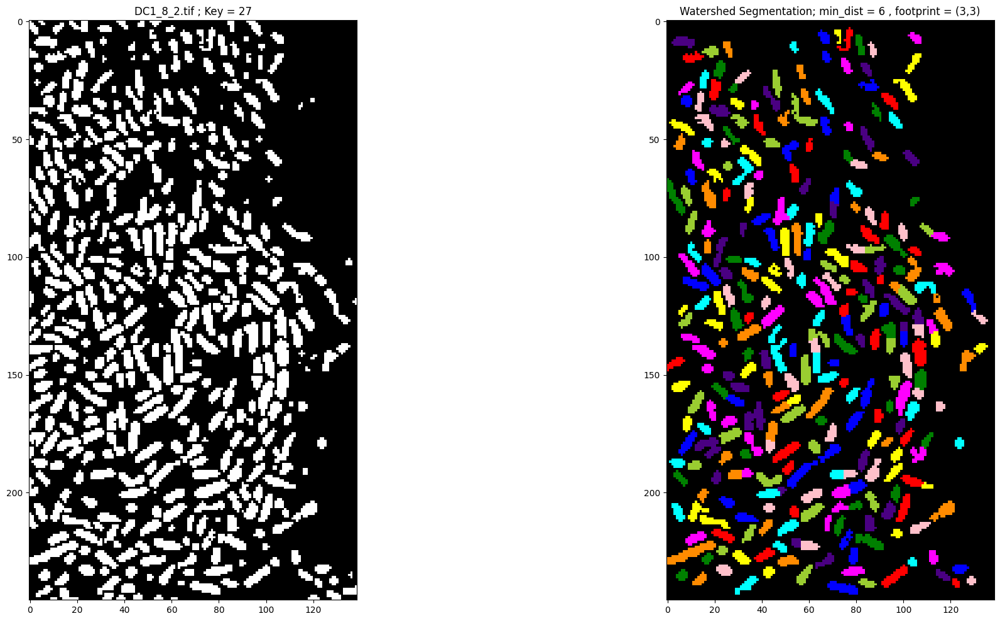

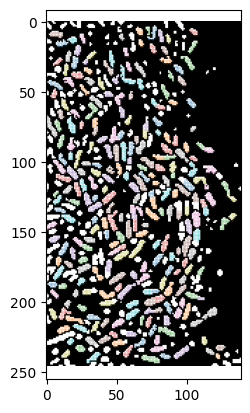

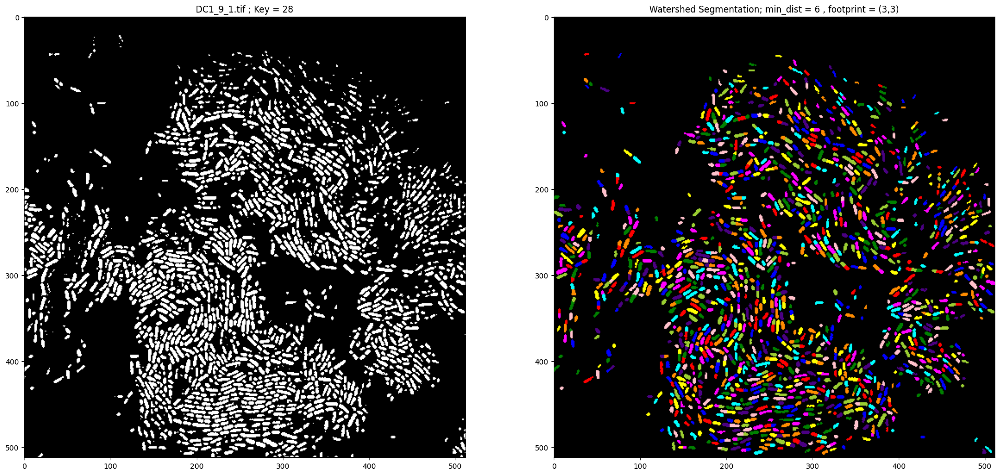

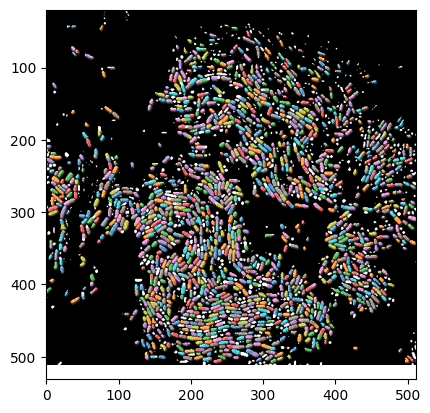

In [4]:
im_DC1 = Image_Proccess(image_DC1, 1, -1)

In [5]:
# apply manual updates to analysis if needed
#image_DC1[1]['Min Dist'] = 8
#update = Image_Proccess(image_DC1, 1, 1)

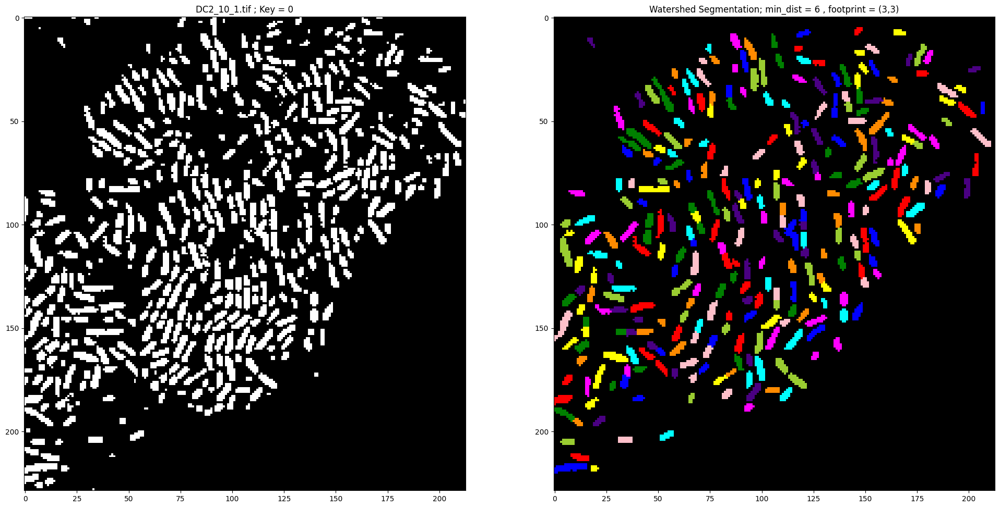

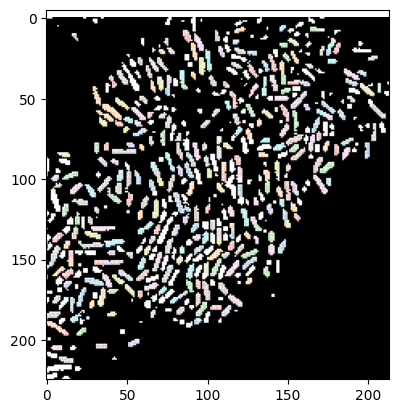

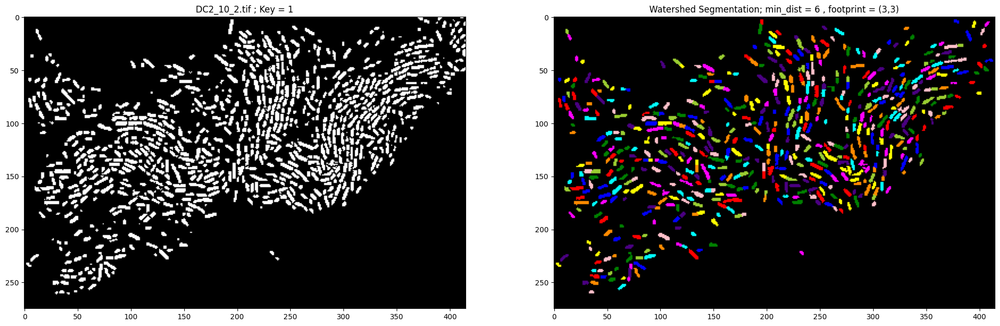

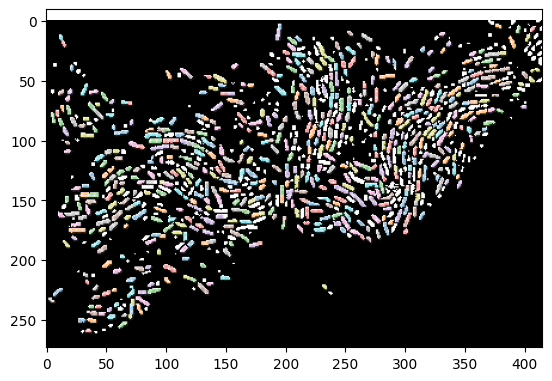

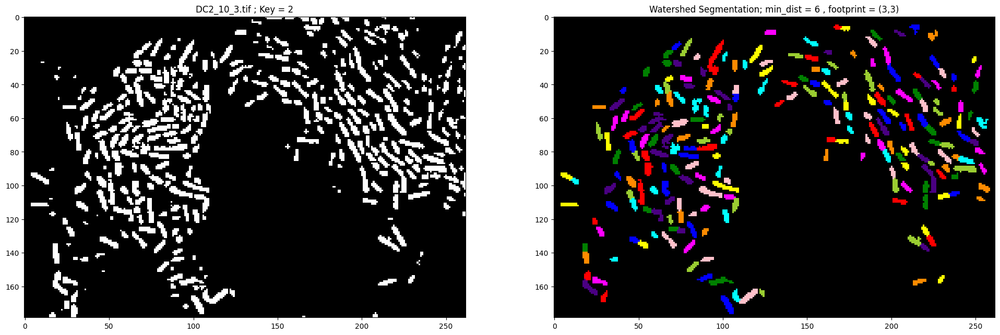

...

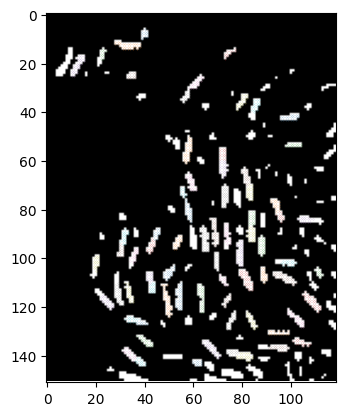

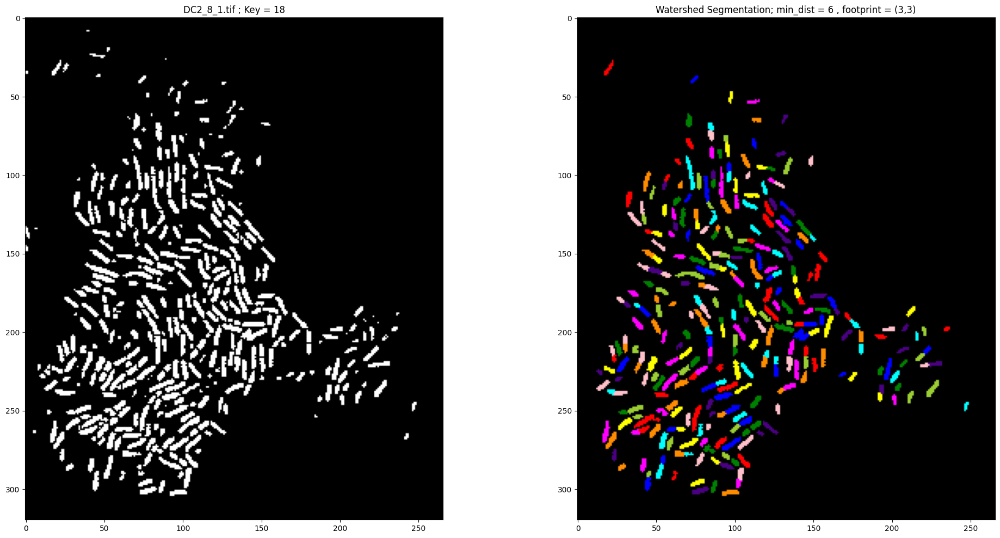

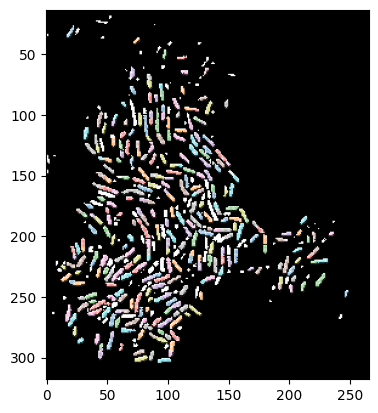

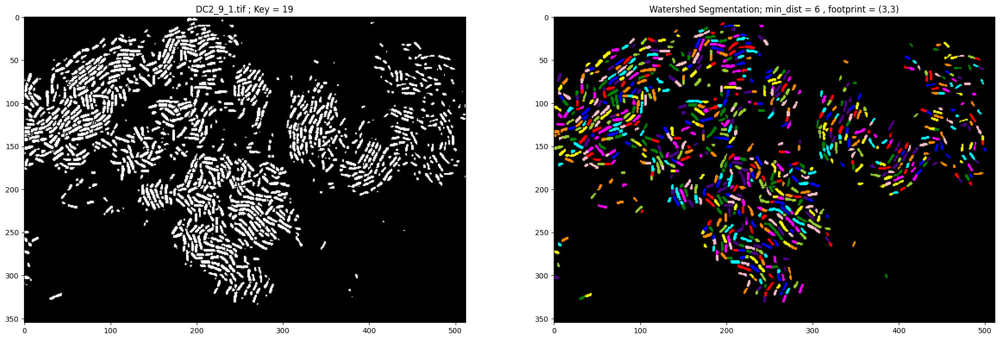

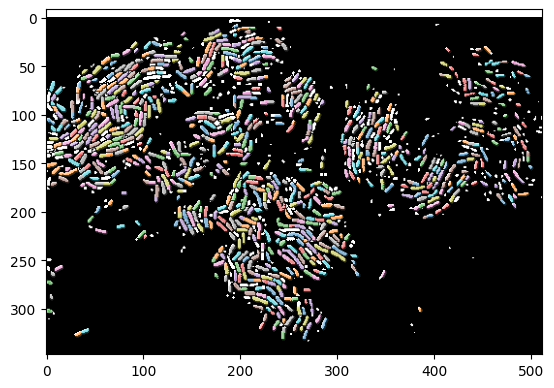

In [6]:
im_DC2 = Image_Proccess(image_DC2, 1, -1)

In [7]:
#update = Image_Proccess(image_DC2, 1, 0)
#image_DC2[0]['Min Dist'] = 7
#update = Image_Proccess(image_DC2, 1, 0)

In [8]:
# saves the list of dictionaries to file for safe keeping - after changes have been made.
np.save('im_DC1.npy',  im_DC1)
np.save('im_DC2.npy',  im_DC2)

In [9]:
# re-loading the disctionary from the file.
im_DC1 = np.load('im_DC1.npy', allow_pickle=True)
im_DC2 = np.load('im_DC2.npy', allow_pickle=True)

In [72]:
def alignment(Orientation):
    """
    getting alignment in degrees
    """
    alignment = []
    for i in Orientation:
        if abs(i) == i:
            theta1 = 90 - i*180/np.pi
            alignment.append(theta1)
        else:
            a = -90 - i*180/np.pi
            theta1 = 180 + a
            alignment.append(theta1)
    return np.array(alignment)*np.pi/180

def local_bins(alignment, distance):
    range_dist = np.max(distance) - np.min(distance)
    interval = range_dist / 50

    mean_s_bin = []
    mean_theta = []
    dist_bin = []
    for i in range(1, 51):
        dist_min = distance > np.min(distance)-i*interval
        dist_max = np.min(distance)+i*interval > distance
        mask = dist_max*dist_min
        alignment_bin = alignment[mask]
        
        mean_theta.append(np.mean(alignment_bin))

        s_bin = abs(np.mean( np.cos(2*alignment_bin)))
        d_bin = np.mean(distance[mask])

        mean_s_bin.append( s_bin )
        dist_bin.append( d_bin )
    plt.scatter(dist_bin, mean_theta)
    #plt.ylim(0, 1.05)
    plt.show()
    return mean_s_bin, dist_bin

def relative_alignment(image_dict, graph):
    """
    yap - current version
    """
    d_list = []
    S_bin_list = []
    
    S_list = []
    S_weight_list = []
    S_err_list = []
    S_nn_list = []
    for j in image_dict:
        image = j
        A = len(image['Orientation'])
        for i in range(round(A)):
            Orient = image['Orientation']
            Dist = image['Centroid']

            relative_orient = np.dot(Orient[i], Orient)
            relative_orient = alignment(relative_orient)
            
            centroid_dist_x = (Dist[:,0] - Dist[i][0])
            centroid_dist_x = np.delete(centroid_dist_x, i)
            centroid_dist_y = (Dist[:,1] - Dist[i][1])
            centroid_dist_y = np.delete(centroid_dist_y, i) # delete point used as origin!
        
            relative_orient = np.delete(relative_orient, i)
            
            distance = np.linalg.norm([centroid_dist_x, centroid_dist_y], axis=0)  
            
            plt.imshow(image['Binary Image'], cmap='gray')
            plt.scatter( Dist[i][0], Dist[i][1])
            plt.show()
            
            if (np.min(distance) == 0):   # none of these elements should be 0? all centriods should be unique
                shite = (0 >= distance) # delete all shite points 
                distance = distance[~shite]
                relative_orient = relative_orient[~shite]
            
            #if (np.max(relative_orient) - np.min(relative_orient)) < 0.01:
            #    print('object '+str(i)+'/'+str(image['Obj Number'])+' in '+str(image['file'])+' removed for obvious non-sense')
            #    continue
                
            #===========NN==================
            distance_nn = 20 > distance # get nearest neighbour
            #distance_nn = distance_nn > 0 # remove weird points which are 0.0 distance from each other
            S_nn = np.cos(2*relative_orient[distance_nn])
            
            if any(distance[distance_nn] < 0) == True:
                print(str(image['file']) + ' ' + str(i))
            
            if any(distance_nn) == True and np.sum(distance[distance_nn]) != 0: # assert array must have stuff and not sum to 0 so weighting will work
                S_nn_weight = np.average(S_nn, weights=distance[distance_nn])
                S_nn_list.append(S_nn_weight)
            else:
                try:
                    print('object '+str(i)+'/'+str(image['Obj Number'])+' in '+str(image['file'])+' cannot compute; 1= '+str(any(distance_nn) == True)+' 2= '+str(np.sum(distance[distance_nn]) != 0))
                    #print(distance_nn)
                    #print(distance[distance_nn])
                    #print(np.min(distance[distance_nn]))
                    #print(np.max(distance[distance_nn]))
                    #print(distance_nn)
                except:
                    a=1
            #============NN=================
            #plt.scatter(distance , relative_orient)
            #plt.show()
            
            S = np.cos(2*relative_orient)

            try:
                S_bin, d_bin = local_bins(relative_orient[distance_nn], distance[distance_nn])
                d_list.append(d_bin)
                S_bin_list.append(S_bin)
            except:
                continue
            
            if graph ==1:
                fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
                ax1.scatter(distance, S, s=1, label='All')
                ax1.scatter(distance_nn, S_nn, s=1, label='NN')
                ax1.set_ylim(-1, 1)
                ax1.set_ylabel('S = Cos^2(theta)')
                ax1.set_xlabel('Distance (centroid seperation) [Pixels]')
                ax1.legend()
                
                ax2.imshow(image['Binary Image'])
                ax2.scatter(Dist[i][0], Dist[i][1])
                ax2.imshow(color.label2rgb(image['Objects'], bg_label=0))
                plt.show()
                
            S_av = np.mean(S)
            S_list.append(S_av)
            S_weight = np.average(S, weights=distance)
            S_weight_list.append(S_weight)
            S_w_std = np.std(S_weight)
            S_err_list.append(S_w_std)
        plt.scatter(d_list, S_bin_list, s=1)
        plt.show()
    return S_list, S_weight_list, S_err_list, S_nn_list, S_bin_list, d_list

In [74]:
S, Sw, Serr, S_nn1, S_bin, d = relative_alignment(im_DC1, 0)
S2, Sw2, Serr2, S_nn2, S2_bin, d2 = relative_alignment(im_DC2, 0)

(0.9, 1.0)

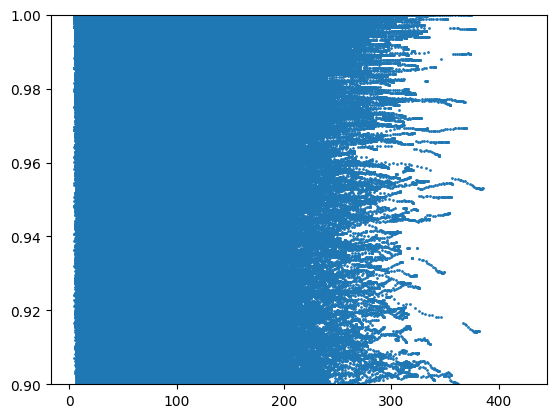

In [47]:
plt.scatter(d, S_bin, s=1)
plt.ylim(0.9, 1)

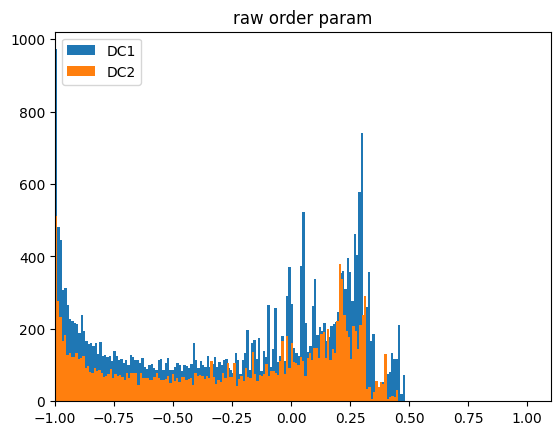

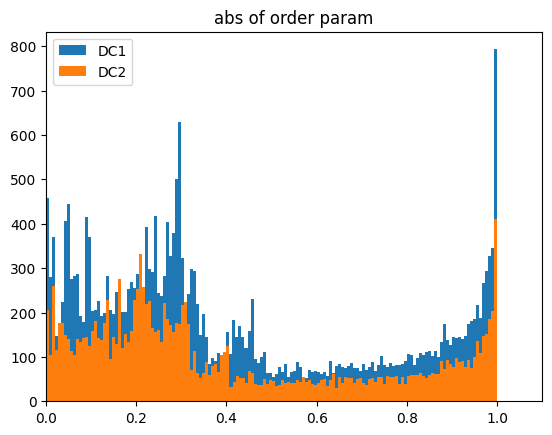

26400.0
15157.0


In [32]:
c_DC1, w_DC1, obj_ = plt.hist(S , bins=150, label='DC1')# '+str(np.sum(c_DC1))+' objects')
c_DC2, w_DC2, obj_ = plt.hist(S2 , bins=150, label='DC2')# '+str(np.sum(c_DC2))+' objects')
plt.xlim(-1, 1.1)
plt.title('raw order param')
plt.legend(loc='upper left')
plt.show()

c_DC1, w_DC1, obj_ = plt.hist(abs(np.array(S)) , bins=150, label='DC1')# '+str(np.sum(c_DC1))+' objects')
c_DC2, w_DC2, obj_ = plt.hist(abs(np.array(S2)) , bins=150, label='DC2')# '+str(np.sum(c_DC2))+' objects')
plt.xlim(0, 1.1)
plt.title('abs of order param')
plt.legend(loc='upper left')
plt.show()

print(np.sum(c_DC1))
print(np.sum(c_DC2))

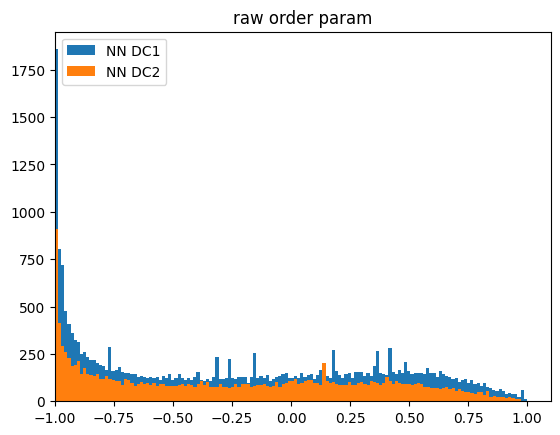

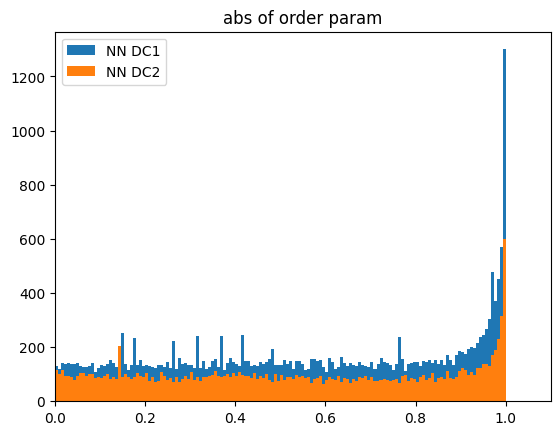

24749.0
14741.0


In [33]:
c_DC1, w_DC1, obj_ = plt.hist(S_nn1 , bins=150, label='NN DC1')# '+str(np.sum(c_DC1))+' objects')
c_DC2, w_DC2, obj_ = plt.hist(S_nn2 , bins=150, label='NN DC2')# '+str(np.sum(c_DC2))+' objects')
plt.xlim(-1, 1.1)
plt.title('raw order param')
plt.legend(loc='upper left')
plt.show()

c_DC1, w_DC1, obj_ = plt.hist(abs(np.array(S_nn1)) , bins=150, label='NN DC1')# '+str(np.sum(c_DC1))+' objects')
c_DC2, w_DC2, obj_ = plt.hist(abs(np.array(S_nn2)) , bins=150, label='NN DC2')# '+str(np.sum(c_DC2))+' objects')
plt.xlim(0, 1.1)
plt.title('abs of order param')
plt.legend(loc='upper left')
plt.show()

print(np.sum(c_DC1))
print(np.sum(c_DC2))

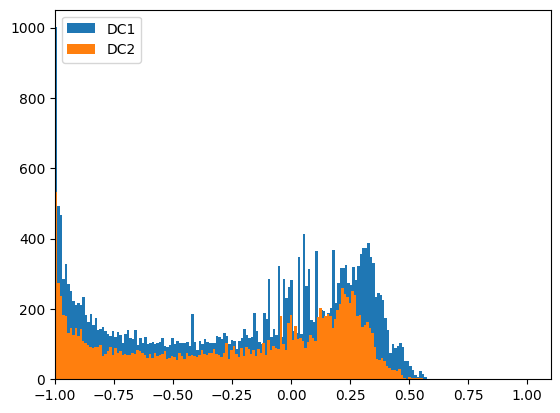

In [29]:
count_DC1, width_DC1, obj = plt.hist(Sw, bins=150, label='DC1')# '+str(np.sum(count_DC1))+' objects')
count_DC2, width_DC2, obj_ = plt.hist(Sw2, bins=150, label='DC2')# '+str(np.sum(count_DC1))+' objects')
plt.xlim(-1, 1.1)
plt.legend(loc='upper left')
plt.show()

In [16]:
# PERCENTAGE OF CELLS IN PERFECT ALIGNMENT (ish)
DC1 = count_DC1[-1]/np.sum(count_DC1)
DC2 = count_DC2[-1]/np.sum(count_DC2)
print(DC1)
print(DC2)

NameError: name 'count_DC1' is not defined